In [7]:
from JupyterImport import *
from src.DatObject.Attributes.SquareEntropy import plot_square_entropy
import src.DatObject.Attributes.SquareEntropy as SE
import progressbar
from sys import stdout
root_logger.setLevel(logging.WARNING)

In [15]:
datnums = sorted(set(range(485, 539+1))-{529})
# datnums = sorted(set(range(900, 953)))
dats = get_dats(datnums, overwrite=False)
for dat in progressbar.progressbar(dats, redirect_stdout=True):
    stdout.flush()
    dat.SquareEntropy.Processed.plot_info.show = SE.ShowPlots(info=True, raw=True, averaged=True, entropy=True)

100% (54 of 54) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


In [16]:
# %matplotlib inline
# for dat in dats:
#     plot_square_entropy(dat.SquareEntropy.Processed);

In [18]:
for dat in progressbar.progressbar(dats, redirect_stdout=True):
    dT = 8.7
#     dT = 8
    amp = dat.Transition.avg_fit.best_values.amp
    
    dat.SquareEntropy.Processed.inputs.dT = dT
    dat.SquareEntropy.Processed.inputs.transition_amplitude = amp
    dat.SquareEntropy.process()
    dat.SquareEntropy.ShowPlots.integrated = True



100% (54 of 54) |########################| Elapsed Time: 0:00:13 Time:  0:00:13


In [19]:
# for dat in dats:
#     plot_square_entropy(dat)

In [20]:
# dd = {dat.datnum: dat for dat in dats}
# dat = dd[508]
# %matplotlib qt
# plot_square_entropy(dat)

100% (54 of 54) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


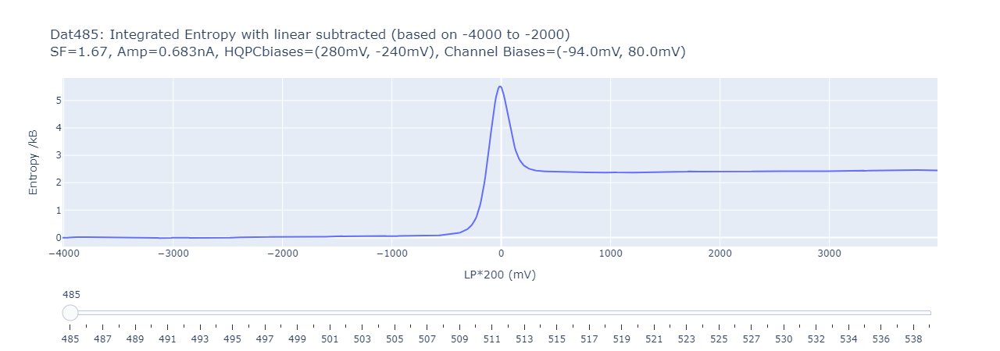

In [23]:
xs, datas, ids, titles = list(), list(), list(), list()
line = lm.models.LinearModel()
for dat in progressbar.progressbar(dats, redirect_stdout=True):
    stdout.flush()
    x = dat.SquareEntropy.Processed.outputs.x
    xs.append(x)
    ids.append(f'{dat.datnum}')
    
    dsp = dat.SquareEntropy.Processed
    ii = dsp.outputs.integrated_info
    text_info = f'SF={ii.sf:.2f}, Amp={ii.amp:.3f}nA, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), ' \
        f'Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV)'
    titles.append(f'Dat{dat.datnum}: Integrated Entropy with linear subtracted (based on -4000 to -2000)<br>{text_info}')
    
    data = dat.SquareEntropy.Processed.outputs.integrated_entropy
    indexs = CU.get_data_index(x, [-4000, -2000])
    fit = line.fit(data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]])
    data = data-fit.eval(x=x)
    datas.append(data)
    
fig = PlU.get_figure(datas=datas, xs=xs, ids=ids, titles=titles, xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB')
# fig.write_html(f'Exports/Dats{dats[0].datnum}-{dats[-1].datnum}Integrated_vs_Channel_bias.html')
fig.show()

100% (54 of 54) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


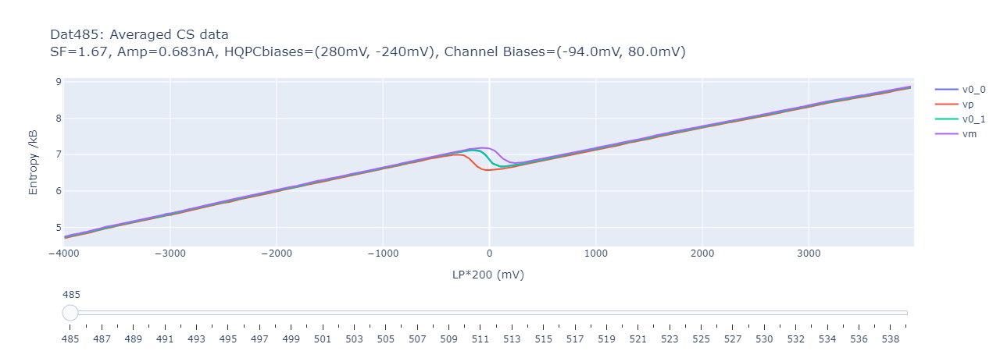

In [24]:
xs, datas, ids, titles = list(), list(), list(), list()
line = lm.models.LinearModel()
for dat in progressbar.progressbar(dats, redirect_stdout=True):
    stdout.flush()
    x = dat.SquareEntropy.Processed.outputs.x
    xs.append(x)
    ids.append(f'{dat.datnum}')
    
    dsp = dat.SquareEntropy.Processed
    ii = dsp.outputs.integrated_info
    text_info = f'SF={ii.sf:.2f}, Amp={ii.amp:.3f}nA, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), ' \
        f'Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV)'
    titles.append(f'Dat{dat.datnum}: Averaged CS data<br>{text_info}')
    
    data = dat.SquareEntropy.Processed.outputs.averaged
#     indexs = CU.get_data_index(x, [-4000, -2000])
#     fit = line.fit(data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]])
#     data = data-fit.eval(x=x)
    datas.append(data)
    
fig = PlU.get_figure(datas=datas, xs=xs, ids=ids, titles=titles, labels=['v0_0', 'vp', 'v0_1', 'vm'], xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB')
fig.write_html(f'Exports/Dats{dats[0].datnum}-{dats[-1].datnum}AveragedCS_vs_Channel_bias.html')
fig.show()